In [1]:
%pwd

u'/mnt/c/Users/rober/HOME/Research/torsional_param/AROMODEL'

In [2]:
import numpy as np
import Atom
import Molecule
import Ring
import OPLS as op
import System
import Conjugated_Polymer
import Cluster_IO
import Write_Inputs
import Write_Submit_Script
import math
import copy
import scipy
import os
import sys
import matplotlib.pyplot as plt
import matplotlib.cm
import matplotlib as mpl
from symfit import parameters, variables, sin, cos, Fit
import re
import time
import dill
from aromodel_lib import *

In [3]:
#File_Location = "~/Torsional_Parameterization"
#os.chdir("/Users/andrewkleinschmidt/Test_New_Torsional_Setup")
Input_File = "/home/rramji/HOME/Research/torsional_param/PEDOT.txt"
XYZ_File = "/home/rramji/HOME/Research/torsional_param/PEDOT.xyz"
#Input_File_Sidechains = "P3HT_Input_With_Sidechains.txt"
#XYZ_File_Sidechains = "P3HT_Input_With_Sidechains.xyz"
Input_File_Sidechains = Input_File
XYZ_File_Sidechains = XYZ_File
Polymer_Name = "PEDOT"
Rotated_Shape = (7,36)
Min_Dih = 0
Max_Dih = 350
Min_OOP = 0
Max_OOP = 60
Fine_Rotated_Shape = (7,36)
Fine_Min_Dih = 0
Fine_Max_Dih = 360
Fine_Min_OOP = 0
Fine_Max_OOP = 30

OOP_Rotations = np.linspace(Min_OOP,Max_OOP,Rotated_Shape[0])
Dih_Rotations = np.linspace(Min_Dih,Max_Dih,Rotated_Shape[1])

In [3]:
%pwd

u'/mnt/c/Users/rober/HOME/Research/torsional_param/AROMODEL'

In [4]:
def Set_Up_Folders(path):
    os.system("mkdir {}/Bond_Parameters".format(path))
    os.system("mkdir {}/Figures".format(path))
    os.system("mkdir {}/Rotation_Run_Input_Copies".format(path))
    os.system("mkdir {}/XYZ_Files".format(path))
    os.system("mkdir {}/Hydrogenated_XYZ_Files".format(path))
    os.system("mkdir {}/Alternate_Hydrogenated_XYZ_Files".format(path))
    os.system("mkdir {}/Nontorsional_Outputs".format(path))
    os.system("mkdir {}/Nontorsional_Inputs".format(path))
    os.system("mkdir {}/Hydrogenated_Improper_XYZ_Files".format(path))
    os.system("mkdir {}/Alternate_Hydrogenated_Improper_XYZ_Files".format(path))
    os.system("mkdir {}/Multi_Ring_Hydrogenated_Rotation_Test".format(path))

In [5]:
Set_Up_Folders('/mnt/c/Users/rober/HOME/Research/torsional_param')

In [6]:
#This function reads in the parameter file, assigns the atoms to rings, adds available LJ, coulombic, bonded, angular, dihedral, and improper potentials, 
#and tells the program whether it needs to parameterize missing bond potentials or partial charges. 
#Ring_List: NumPy array of Ring objects categorizing all available atoms into separate rings; 
#Paramaterize_Bond: Boolean that equals "True" if bond parameters for interring bonds have not been specified; 
#Paramaterize_Charges: Boolean that equals "True" if partial charges for atoms have not been specified

Ring_List,Parameterize_Bond,Parameterize_Charges = Read_Input(Input_File,XYZ_File,Polymer_Name) 

Ring.py:57: RuntimeWarning: invalid value encountered in divide
  self.Normal_Vector = self.Normal_Vector/np.linalg.norm(self.Normal_Vector)
Bonded_Atom.py:22: RuntimeWarning: invalid value encountered in divide
  temp_angle = math.acos(np.dot((self.Central_Atom.Position - temp_atom.Position)/np.linalg.norm(self.Central_Atom.Position - temp_atom.Position),self.Bonded_Vector/np.linalg.norm(self.Bonded_Vector)))


KeyboardInterrupt: 

In [8]:
%ls

 Analyze_Traj.py*
 Analyze_Traj.pyc*
 Analyze_Traj_Test.py*
 Angle.py*
 Angle.pyc*
 Aromodel.py*
 Atom.py*
 Atom.pyc*
 Attempt.xyz*
 Aux_Ring.py*
 Aux_Ring.pyc*
 BlockPedot.inp*
 BlockPedot.out*
 BlockPedot.xyz*
 Bond.py*
 Bond.pyc*
 Bonded_Atom.py*
 Bonded_Atom.pyc*
 Cluster_IO.py*
 Cluster_IO.pyc*
 Comet.py*
 Comet.pyc*
 Configure.py*
 Configure.pyc*
 Conjugated_Polymer.py*
 Conjugated_Polymer.pyc*
 DA_Main.py*
 DA_Polymer.py*
 DA_Polymer.pyc*
 DA_Strain.py*
 Dihedral.py*
 Dihedral.pyc*
 Ecalc_2-out.mmo*
 Furan.txt*
 Furan.xyz*
 Furan2.txt*
 Furan2.xyz*
 IBI.py*
 Improper.py*
 Improper.pyc*
 Lammps.py*
 Lammps.pyc*
 Main.py*
 Make_DA_Polymer.py*
 Molecule.py*
 Molecule.pyc*
 OPLS.py*
 OPLS.pyc*
 Optimized_Monomers/
 Orca/
 PEDOT_Ethyldioxothiophene_1.xyz*
 PEDOT_Ethyldioxothiophene_1_Optimize_Monomer.inp*
 PEG.xyz*
 PEGAcrylate.xyz*
 PSS.xyz*
 Parallel.py*
 Parallel.pyc*
 Plot.py*
 Polymer.py*
 Polymer.pyc*
 PolymerBuilder.py*
 Post_Process/
 Post_Process.py*
 README.md*
 Ring.py*
 R

In [37]:
if Parameterize_Charges:
    Find_Charges(Ring_List,Polymer_Name) #Assign charges to each atom in each ring

In [38]:
if Parameterize_Bond:
    Strech_Bond(Ring_List,Polymer_Name) #Assign spring constants and equilibrium lengths to each interring potential

In [39]:
Make_Example_Files(Ring_List)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [40]:
Offset_Ring_List = []
for ring in Ring_List[1:]:
    Offset_Ring_List.append(copy.deepcopy(ring))

In [41]:
Offset_Ring_List.append(copy.deepcopy(Ring_List[0]))
for ring1,ring2 in zip(Ring_List,Offset_Ring_List):
    Dimer = Conjugated_Polymer.Conjugated_Polymer([ring1,ring2])
    XYZ_Filename = Dimer.Write_XYZ()
    Hydrogenated_Dimer,_ = Dimer.Create_Hydrogenated_Copy(0,1)
    print(Hydrogenated_Dimer.Ring_List[0].Name)
    print(Hydrogenated_Dimer.Ring_List[0].Normal_Vector)
    print(Hydrogenated_Dimer.Ring_List[1].Normal_Vector)
    Hydrogenated_Dimer.Ring_List[1].Show_Normal_Vector()
    XYZ_Filename = Hydrogenated_Dimer.Write_XYZ()

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [42]:
Offset_Ring_List = []
Dual_Offset_Ring_List = []
Full_Trimer_Nontorsional_Energy_List = []
for ring in Ring_List[1:]:
    Offset_Ring_List.append(copy.deepcopy(ring))
for ring in Ring_List[2:]:
    Dual_Offset_Ring_List.append(copy.deepcopy(ring))

Offset_Ring_List.append(copy.deepcopy(Ring_List[0]))
Dual_Offset_Ring_List.append(copy.deepcopy(Ring_List[0]))
Dual_Offset_Ring_List.append(copy.deepcopy(Ring_List[1]))

In [43]:
for ring1,ring2,ring3 in zip(Ring_List,Offset_Ring_List,Dual_Offset_Ring_List):
    Trimer = Conjugated_Polymer.Conjugated_Polymer([ring1,ring2,ring3])
    XYZ_Filename = Trimer.Write_XYZ()

Linking Now
1
5
Linking Now
5
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
23
S
H
New H Atom
C
28
H
New H Atom
C
28
H
New H Atom
C
28
H
New H Atom
C
26
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.

In [44]:
Extended_Ring_List = copy.deepcopy(Ring_List)
for i in range(1):
    for j in range(1):
        Extended_Ring_List.append(copy.deepcopy(Ring_List[j]))
Multimer = Conjugated_Polymer.Conjugated_Polymer(Extended_Ring_List)
Multimer.Write_XYZ()

Linking Now
1
5
Linking Now
5
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
23
S
H
New H Atom
C
28
H
New H Atom
C
28
H
New H Atom
C
28
H
New H Atom
C
26
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.

'Methylthiophene_Phi_0_Theta_0_Methylthiophene_Phi_0_Theta_0_Methylthiophene.xyz'

In [45]:
#Forms n-mers of the rings up until a percentage limit of change is reached, then rotates their rings and calculates RI-MP2 energies, LAMMPS energies without bonded interactions, and nonbonded interaction energies; Returns N: the maximum number of rings tested; Torsional_Energies: an N by len(Ring_List) by Rotated_Shape[0] by Rotated_Shape[1]
LAMMPS_Energies = np.zeros(Rotated_Shape)
Quantum_Energies = np.zeros(Rotated_Shape)
Nonbonded_Energies = np.zeros(Rotated_Shape)

Offset_Ring_List = []
Dual_Offset_Ring_List = []
for ring in Ring_List[1:]:
    Offset_Ring_List.append(ring)

for ring in Ring_List[2:]:
    Dual_Offset_Ring_List.append(ring)

Offset_Ring_List.append(Ring_List[0])
Dual_Offset_Ring_List.append(Ring_List[0])
Dual_Offset_Ring_List.append(Ring_List[1])

Dih_Rotations_Degrees = np.linspace(0,Max_Dih + Max_Dih/Rotated_Shape[1]-1,Rotated_Shape[1]+1)
OOP_Rotations_Degrees = np.linspace(0,Max_OOP + Max_OOP/Rotated_Shape[0]-1,Rotated_Shape[0]+1)

In [46]:
#Calculate_Statistics(Input_File_Sidechains,XYZ_File_Sidechains,Polymer_Name,15,3)

In [47]:
Run_SPE_Methyl_Impropers(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

Methylthiophene
Setting up molecule
Molecule Name: Methylthiophene_XYZ_Improper_Bend_Methyl_Phi_0
15 Atoms in  Methylthiophene_XYZ_Improper_Bend_Methyl_Phi_0
----------------------------------
Initial XYZ Coordinates:

C [0. 0. 0.]
C [-4.700000e-05 -8.443460e-01 -1.113221e+00]
C [ 2.590000e-04 -2.235394e+00 -8.211090e-01]
H [-1.030000e-04 -4.560040e-01 -2.142989e+00]
C [ 4.960000e-04 -2.483874e+00  5.629980e-01]
S [-2.040000e-04 -9.709620e-01  1.464517e+00]
C [ 5.010000e-04 -3.299753e+00 -1.883164e+00]
H [ 3.240000e-04 -2.851562e+00 -2.895652e+00]
H [-0.891737 -3.956024 -1.809077]
H [ 0.893118 -3.95552  -1.809171]
C [-0.        1.450135 -0.      ]
H [-1.008267  1.837173 -0.      ]
H [ 0.504133  1.837173 -0.873185]
H [0.504133 1.837173 0.873185]
H [ 6.380000e-04 -3.442033e+00  1.096296e+00]
----------------------------------
Molecular Weight is  224.38 Grams/Mole
COM is [ 4.56278233e-05 -5.76665444e-01  1.07668161e-03]
The Radius of Gyration is 1.40485974212355
[0. 0. 0.]
Job Exists
Set

In [48]:
Run_SPE_Methyl_Impropers(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name)

Methylthiophene
Setting up molecule
Molecule Name: Methylthiophene_XYZ_Improper_Bend_Methyl_Phi_0
15 Atoms in  Methylthiophene_XYZ_Improper_Bend_Methyl_Phi_0
----------------------------------
Initial XYZ Coordinates:

C [0. 0. 0.]
C [-4.700000e-05 -8.443460e-01 -1.113221e+00]
C [ 2.590000e-04 -2.235394e+00 -8.211090e-01]
H [-1.030000e-04 -4.560040e-01 -2.142989e+00]
C [ 4.960000e-04 -2.483874e+00  5.629980e-01]
S [-2.040000e-04 -9.709620e-01  1.464517e+00]
C [ 5.010000e-04 -3.299753e+00 -1.883164e+00]
H [ 3.240000e-04 -2.851562e+00 -2.895652e+00]
H [-0.891737 -3.956024 -1.809077]
H [ 0.893118 -3.95552  -1.809171]
C [-0.        1.450135 -0.      ]
H [-1.008267  1.837173 -0.      ]
H [ 0.504133  1.837173 -0.873185]
H [0.504133 1.837173 0.873185]
H [ 6.380000e-04 -3.442033e+00  1.096296e+00]
----------------------------------
Molecular Weight is  224.38 Grams/Mole
COM is [ 4.56278233e-05 -5.76665444e-01  1.07668161e-03]
The Radius of Gyration is 1.40485974212355
[0. 0. 0.]
Job Exists
Set

In [49]:
Ring_By_Ring_Dual_Hydrogenated_End_File_Matrices = Run_Paired_Hydrogenation_Energy(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

Linking Now
1
5
Linking Now
5
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
23
S
H
New H Atom
C
28
H
New H Atom
C
28
H
New H Atom
C
28
H
New H Atom
C
26
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.

In [50]:
Ring_By_Ring_End_File_Matrices,Ring_By_Ring_Nontorsional_Energy,Ring_By_Ring_Improper_File_Matrices = Run_SPE_Dimers(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [51]:
Ring_By_Ring_End_File_Matrices_Fine,Ring_By_Ring_Nontorsional_Energy_Fine,Ring_By_Ring_Improper_File_Matrices_Fine = Run_SPE_Dimers(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [52]:
Ring_By_Ring_End_File_Matrices_Hydrogenated,Ring_By_Ring_Hydrogenated_Energy = Run_SPE_Dimers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [53]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Fine,Ring_By_Ring_Hydrogenated_Energy_Fine = Run_SPE_Dimers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [54]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Alternate,Ring_By_Ring_Hydrogenated_Energy_Alternate = Run_SPE_Dimers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Alternate=True)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [55]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Alternate_Fine,Ring_By_Ring_Hydrogenated_Energy_Alternate_Fine = Run_SPE_Dimers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Alternate=True)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [56]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers,Ring_By_Ring_Nontorsional_Energy_HI = Run_SPE_Impropers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [57]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers_Fine,Ring_By_Ring_Nontorsional_Energy_HI_Fine = Run_SPE_Impropers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [58]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers_Alternate,Ring_By_Ring_Nontorsional_Energy_HI_Alternate = Run_SPE_Impropers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Alternate=True)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [59]:
Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers_Alternate_Fine,Ring_By_Ring_Nontorsional_Energy_HI_Alternate_Fine = Run_SPE_Impropers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Alternate=True)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [60]:
#Ring_By_Ring_End_File_Matrices_Trimer,Ring_By_Ring_Trimer_Nontorsional_Energy = Run_SPE_Trimers_Dih(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

In [61]:
#Ring_By_Ring_End_File_Matrices_Hydrogenated_Trimer,Syn_Anti_Matrices = Run_SPE_Trimers_Hydrogenated_Dih(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name)

In [62]:
Ring_By_Ring_Methyl_Impropers,Ring_By_Ring_Methyl_Improper_Lists,Dimer_Names = Return_SPE_Methyl_Impropers(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_Improper_File_Matrices)

Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists

In [63]:
Ring_By_Ring_Methyl_Impropers_Fine,Ring_By_Ring_Methyl_Improper_Lists_Fine,Dimer_Names_Fine = Return_SPE_Methyl_Impropers(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Ring_By_Ring_Improper_File_Matrices_Fine)

Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists
Job Exists

In [64]:
Ring_By_Ring_Hydrogenated_Energies = Return_SPE_Dimers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [65]:
Ring_By_Ring_Hydrogenated_Energies_Fine = Return_SPE_Dimers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Fine)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [66]:
Ring_By_Ring_Hydrogenated_Alternate_Energies = Return_SPE_Dimers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Alternate,Alternate=True)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [67]:
Ring_By_Ring_Hydrogenated_Alternate_Energies_Fine = Return_SPE_Dimers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Alternate_Fine,Alternate=True)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [68]:
Combined_Ring_By_Ring_Hydrogenated_Energies,Combined_Ring_By_Ring_Hydrogenated_Energies_Tracker = Merge_Hydrogenated_Energies(Ring_By_Ring_Hydrogenated_Energies,Ring_By_Ring_Hydrogenated_Alternate_Energies)

Regular:
3.034229815006256
Alternate:
0.20194004196673632
Regular:
3.024498356739059
Alternate:
0.1194303180091083
Regular:
2.8743284452939406
Alternate:
0.01903772249352187
Regular:
2.5626670161727816
Alternate:
0.0
Regular:
2.1021206075092778
Alternate:
0.03323911421466619
Regular:
1.527869692654349
Alternate:
0.09652851324062794
Regular:
0.9578006261726841
Alternate:
0.1702920168172568
Regular:
0.45890800619963557
Alternate:
0.23475640953984112
Regular:
0.14020998042542487
Alternate:
0.2908057135064155
Regular:
0.010488223284482956
Alternate:
0.3411440144991502
Regular:
0.09292509441729635
Alternate:
0.38184278609696776
Regular:
0.36023162316996604
Alternate:
0.36731534532736987
Regular:
0.7825412567472085
Alternate:
0.312448502285406
Regular:
1.3467492850031704
Alternate:
0.24957268859725446
Regular:
2.044757820549421
Alternate:
0.3042808995814994
Regular:
2.808540341327898
Alternate:
0.5095599945634604
Regular:
3.425719848717563
Alternate:
0.779223789810203
Regular:
3.803508859244

In [69]:
Combined_Ring_By_Ring_Hydrogenated_Energies_Fine,Combined_Ring_By_Ring_Hydrogenated_Energies_Tracker_Fine = Merge_Hydrogenated_Energies(Ring_By_Ring_Hydrogenated_Energies_Fine,Ring_By_Ring_Hydrogenated_Alternate_Energies_Fine)

Regular:
3.034229815006256
Alternate:
0.4289323939010501
Regular:
3.024498356739059
Alternate:
0.3464226699434221
Regular:
2.8743284452939406
Alternate:
0.24603007442783564
Regular:
2.5626670161727816
Alternate:
0.22699235193431377
Regular:
2.1021206075092778
Alternate:
0.26023146614897996
Regular:
1.527869692654349
Alternate:
0.3235208651749417
Regular:
0.9578006261726841
Alternate:
0.3972843687515706
Regular:
0.45890800619963557
Alternate:
0.4617487614741549
Regular:
0.14020998042542487
Alternate:
0.5177980654407293
Regular:
0.010488223284482956
Alternate:
0.568136366433464
Regular:
0.09292509441729635
Alternate:
0.6088351380312815
Regular:
0.36023162316996604
Alternate:
0.5943076972616836
Regular:
0.7825412567472085
Alternate:
0.5394408542197198
Regular:
1.3467492850031704
Alternate:
0.47656504053156823
Regular:
2.044757820549421
Alternate:
0.5312732515158132
Regular:
2.808540341327898
Alternate:
0.7365523464977741
Regular:
3.425719848717563
Alternate:
1.0062161417445168
Regular:
3.

In [70]:
Ring_By_Ring_Hydrogenated_Improper_Energies = Return_SPE_Dimers_Impropers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers)

Dimer Matrix size:
Hydrogenated
Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18

In [71]:
Ring_By_Ring_Hydrogenated_Improper_Energies_Fine = Return_SPE_Dimers_Impropers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers_Fine)

Dimer Matrix size:
Hydrogenated
Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18

In [72]:
Ring_By_Ring_Hydrogenated_Alternate_Improper_Energies = Return_SPE_Dimers_Impropers_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers_Alternate,Alternate=True)

Dimer Matrix size:
Hydrogenated
Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18

In [73]:
Ring_By_Ring_Hydrogenated_Alternate_Improper_Energies_Fine = Return_SPE_Dimers_Impropers_Hydrogenated(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Impropers_Alternate_Fine,Alternate=True)

Dimer Matrix size:
Hydrogenated
Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18

In [74]:
Combined_Ring_By_Ring_Hydrogenated_Improper_Energies,Combined_Ring_By_Ring_Hydrogenated_Improper_Energies_Tracker = Merge_Hydrogenated_Improper_Energies(Ring_By_Ring_Hydrogenated_Improper_Energies,Ring_By_Ring_Hydrogenated_Alternate_Improper_Energies,Combined_Ring_By_Ring_Hydrogenated_Energies_Tracker)

In [75]:
Combined_Ring_By_Ring_Hydrogenated_Improper_Energies_Fine,Combined_Ring_By_Ring_Hydrogenated_Improper_Energies_Tracker_Fine = Merge_Hydrogenated_Improper_Energies(Ring_By_Ring_Hydrogenated_Improper_Energies_Fine,Ring_By_Ring_Hydrogenated_Alternate_Improper_Energies_Fine,Combined_Ring_By_Ring_Hydrogenated_Energies_Tracker_Fine)

In [76]:
Dimer_Energies,Dimer_Energies_Dict,Dimer_Energies_Corrected = Return_SPE_Dimers(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices,Ring_By_Ring_Nontorsional_Energy,Ring_By_Ring_Hydrogenated_Energies)

Dimer Matrix size:
(4, 7, 36)
Dimer Nonbonded Matrix size:
(4, 7, 36)
Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16

In [77]:
Dimer_Energies_Fine,Dimer_Energies_Dict_Fine,Dimer_Energies_Corrected_Fine = Return_SPE_Dimers(Ring_List,Fine_Rotated_Shape,Fine_Max_Dih,Fine_Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Fine,Ring_By_Ring_Nontorsional_Energy_Fine,Ring_By_Ring_Hydrogenated_Energies_Fine)

Dimer Matrix size:
(4, 7, 36)
Dimer Nonbonded Matrix size:
(4, 7, 36)
Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16

In [78]:
OPLS_Fit_list = Control_Fit_OPLS(Dimer_Energies,Rotated_Shape)

2.6925204352484835
0.14172804184867535
[0.0, 3.634953963845694e-05, 0.00014542235357451475, 0.00032729100318590245, 0.0005820763451685601, 0.0009099474131958501, 0.001311121252358301, 0.0017858627065013679, 0.002334484158611586, 0.0029573452244356733, 0.0036548523995488602, 0.004427458660122483, 0.005275663017673599, 0.0062000100281124175, 0.007201089255435007, 0.008279534690442021, 0.00943602412489367, 0.01067127848154676, 0.011986061100548263, 0.013381176982690497, 0.014857471990065315, 0.016415832004686534, 0.018057182045674254, 0.019782485345630478, 0.021592742386862422, 0.023488989898136685, 0.025472299812677228, 0.02754377818815234, 0.029704564089412425, 0.03195582843477893, 0.03429877280670418, 0.0367346282276501, 0.0392646539020558, 0.04189013592529589, 0.0446123859605458, 0.047432739884502126, 0.050352556402924256, 0.05337321563698763, 0.05649611768145678, 0.05972268113571687, 0.0630543416087059, 0.06649255019883175, 0.07003877194995205, 0.07369448428453122, 0.0774611754151052

In [79]:
#Merged_OOP_Rotations_Degrees,Merged_Raw_Dimer_Energies = Merge_Coarse_Fine(Rotated_Shape,Max_OOP,Max_Dih,Fine_Rotated_Shape,Fine_Max_OOP,Fine_Max_Dih,Dimer_Energies,Dimer_Energies_Fine)

In [80]:
#Check this-- Merged Raw Dimer Energies is based on corrected #. Doesn't appear to matter but still
Merged_OOP_Rotations_Degrees,Merged_Raw_Dimer_Energies = Merge_Coarse_Fine(Rotated_Shape,Max_OOP,Max_Dih,Fine_Rotated_Shape,Fine_Max_OOP,Fine_Max_Dih,Dimer_Energies_Corrected,Dimer_Energies_Corrected_Fine)

[0.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, 40.0, 50.0, 60.0]
(4, 10, 36)


In [81]:
Dimer_Weights = Weight_Impropers(Merged_Raw_Dimer_Energies,5000)

In [82]:
#Dually_Hydrogenated_Energies = Return_Dually_Hydrogenated(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_Dual_Hydrogenated_End_File_Matrices,Syn_Anti_Matrices)

In [83]:
Ring_By_Ring_Nonbonded_Energies = np.asarray(Combined_Ring_By_Ring_Hydrogenated_Energies) - np.asarray(Combined_Ring_By_Ring_Hydrogenated_Improper_Energies)

In [84]:
Nonbonded_Energies = np.array(Ring_By_Ring_Hydrogenated_Energies) - np.array(Ring_By_Ring_Hydrogenated_Improper_Energies)
Nonbonded_Energies_Alternate = np.array(Ring_By_Ring_Hydrogenated_Alternate_Energies) - np.array(Ring_By_Ring_Hydrogenated_Alternate_Improper_Energies)

In [85]:
Ring_By_Ring_Nonbonded_Energies,_ = Merge_Hydrogenated_Energies(Nonbonded_Energies,Nonbonded_Energies_Alternate)

Regular:
1.3316815039725043
Alternate:
0.20194004196673632
Regular:
1.309894641279243
Alternate:
0.10717411350924522
Regular:
1.1724336755578406
Alternate:
-0.06276104401331395
Regular:
0.9578348876675591
Alternate:
-0.22048423573141918
Regular:
0.703264789248351
Alternate:
-0.3693239100975916
Regular:
0.440654972451739
Alternate:
-0.515832923760172
Regular:
0.24528460449073464
Alternate:
-0.6357055037515238
Regular:
0.10109068918973207
Alternate:
-0.7490994600229897
Regular:
0.03510718169854954
Alternate:
-0.8240394005551934
Regular:
0.009883878054097295
Alternate:
-0.8588896210421808
Regular:
0.02677272673463449
Alternate:
-0.8560383864096366
Regular:
0.06327515468001366
Alternate:
-0.8558980774250813
Regular:
0.1366203667712398
Alternate:
-0.8537795119918883
Regular:
0.2973502248059958
Alternate:
-0.813887077907566
Regular:
0.611959774279967
Alternate:
-0.6347971974755637
Regular:
1.0693194870837033
Alternate:
-0.2894552079960704
Regular:
1.469131488527637
Alternate:
0.0960887612309

In [86]:
for names,energies in zip(Dimer_Names,Ring_By_Ring_Nonbonded_Energies):
    energies = energies - np.amin(energies[0])
    fig,ax = plt.subplots(1,1)
    x,y = np.meshgrid(Dih_Rotations_Degrees,OOP_Rotations_Degrees)
    c = ax.pcolor(x,y,energies,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Nonbonded Energies',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Nonbonded_Energies' % (names[0],names[1]))
    plt.close(fig)

for ring in Ring_By_Ring_Nonbonded_Energies:
    ring = ring - np.amin(ring[0])

In [87]:
E_conjugation = np.asarray(Ring_By_Ring_Methyl_Impropers)
Dimer_Energies = np.asarray(Dimer_Energies)

E_delocalization = Dimer_Energies - E_conjugation - Ring_By_Ring_Nonbonded_Energies
#E_delocalization = Dimer_Energies - Ring_By_Ring_Nonbonded_Energies

In [88]:
Dih_Rotations_Degrees = np.linspace(0,Max_Dih + Max_Dih/Rotated_Shape[1]-1,Rotated_Shape[1]+1)
OOP_Rotations_Degrees = np.linspace(0,Max_OOP + Max_OOP/Rotated_Shape[0]-1,Rotated_Shape[0]+1)
print(E_delocalization.shape)
print(len(Dih_Rotations_Degrees))
print(len(OOP_Rotations_Degrees))
Make_Surface_Plot(Dih_Rotations_Degrees,OOP_Rotations_Degrees,E_delocalization[0],'%s_Unfit_Conjugated_Energies' % (Polymer_Name),Title='RI-MP2 Energies',xlabel='Dihedral (degrees)',ylabel='Out of Plane (degrees)')

(4, 7, 36)
37
8


In [89]:
Ring_By_Ring_Nonbonded_Energies_Fine = np.asarray(Combined_Ring_By_Ring_Hydrogenated_Energies_Fine) - np.asarray(Combined_Ring_By_Ring_Hydrogenated_Improper_Energies_Fine)

Nonbonded_Energies_Fine = np.array(Ring_By_Ring_Hydrogenated_Energies_Fine) - np.array(Ring_By_Ring_Hydrogenated_Improper_Energies_Fine)
Nonbonded_Energies_Alternate_Fine = np.array(Ring_By_Ring_Hydrogenated_Alternate_Energies_Fine) - np.array(Ring_By_Ring_Hydrogenated_Alternate_Improper_Energies_Fine)
Ring_By_Ring_Nonbonded_Energies_Fine,_ = Merge_Hydrogenated_Energies(Nonbonded_Energies_Fine,Nonbonded_Energies_Alternate_Fine)

for ring in Ring_By_Ring_Nonbonded_Energies:
    ring = ring - np.amin(ring[0])

E_conjugation_Fine = np.asarray(Ring_By_Ring_Methyl_Impropers_Fine)
Dimer_Energies_Fine = np.asarray(Dimer_Energies_Fine)
E_delocalization_Fine = Dimer_Energies_Fine - E_conjugation_Fine - Ring_By_Ring_Nonbonded_Energies_Fine
#E_delocalization_Fine = Dimer_Energies_Fine - Ring_By_Ring_Nonbonded_Energies_Fine

Regular:
1.3316815039725043
Alternate:
0.29158167995046824
Regular:
1.309894641279243
Alternate:
0.19681575149297714
Regular:
1.1724336755578406
Alternate:
0.026880593970417976
Regular:
0.9578348876675591
Alternate:
-0.13084259774768725
Regular:
0.703264789248351
Alternate:
-0.27968227211385965
Regular:
0.440654972451739
Alternate:
-0.42619128577644005
Regular:
0.24528460449073464
Alternate:
-0.5460638657677919
Regular:
0.10109068918973207
Alternate:
-0.6594578220392577
Regular:
0.03510718169854954
Alternate:
-0.7343977625714615
Regular:
0.009883878054097295
Alternate:
-0.7692479830584489
Regular:
0.02677272673463449
Alternate:
-0.7663967484259047
Regular:
0.06327515468001366
Alternate:
-0.7662564394413494
Regular:
0.1366203667712398
Alternate:
-0.7641378740081564
Regular:
0.2973502248059958
Alternate:
-0.7242454399238341
Regular:
0.611959774279967
Alternate:
-0.5451555594918318
Regular:
1.0693194870837033
Alternate:
-0.19981357001233846
Regular:
1.469131488527637
Alternate:
0.18573039

In [90]:
Merged_OOP_Rotations_Degrees,Merged_Delocalization_Energies = Merge_Coarse_Fine(Rotated_Shape,Max_OOP,Max_Dih,Fine_Rotated_Shape,Fine_Max_OOP,Fine_Max_Dih,E_delocalization,E_delocalization_Fine)

[0.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, 40.0, 50.0, 60.0]
(4, 10, 36)


In [91]:
Merged_OOP_Rotations_Degrees,Merged_Conjugation_Energies = Merge_Coarse_Fine(Rotated_Shape,Max_OOP,Max_Dih,Fine_Rotated_Shape,Fine_Max_OOP,Fine_Max_Dih,E_conjugation,E_conjugation_Fine)

[0.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, 40.0, 50.0, 60.0]
(4, 10, 36)


In [92]:
Merged_OOP_Rotations_Degrees,Merged_Nonbonded_Energies = Merge_Coarse_Fine(Rotated_Shape,Max_OOP,Max_Dih,Fine_Rotated_Shape,Fine_Max_OOP,Fine_Max_Dih,Ring_By_Ring_Nonbonded_Energies,Ring_By_Ring_Nonbonded_Energies_Fine)

[0.0, 5.0, 10.0, 15.0, 20.0, 25.0, 30.0, 40.0, 50.0, 60.0]
(4, 10, 36)


In [93]:
Force_x,Force_y,Fit_Energies,Deloc_Coarse_Energies,a_params_list,b_params_list,a0_params_list = Fit_Improper_Energies(Merged_Delocalization_Energies,Ring_List,Rotated_Shape,Merged_OOP_Rotations_Degrees,Dimer_Weights)

[[-28.368911124867573, -30.578862345490734, 59.143689931655395, -44.34785344789382, 17.447363425853595, -3.0423830641268643], [836.2031958627764, -650.4318154222613, 406.22443944301216, -186.87517013641659, 55.86338868240009, -8.222636010630316], [-710.3872196192649, 452.6075221903726, -206.0583915639653, 62.56406015586408, -10.755734375231695, 0.6508169678231343], [10.383994787231755, 12.06956445100758, -21.75650759752678, 15.88287150894093, -6.179059067176393, 1.0575004931375402], [-98.00705825756347, -111.48785084998346, 205.0998288377952, -152.49819414272554, 60.31470115413128, -10.6878693909687]]
[[0.07489338853783835, -0.10061651818202097, 0.0757001717758954, -0.03592474906688623, 0.01020160895448855, -0.0013458007213179497], [0.19579199789217616, 0.3311088780429587, -1.0363903987282466, 1.0616545297413063, -0.535561360402382, 0.11472666952066544], [-2.2489883040941807, 3.1421327433859734, -2.5244911445847498, 1.3147960951605222, -0.4217264076720966, 0.06484240278845407], [0.0748

In [94]:
Nonbonded_Force_x,Nonbonded_Force_y,Nonbonded_Fit_Energies,Nonbonded_Coarse_Energies,Nonbonded_a_params_list,Nonbonded_b_params_list,Nonbonded_a0_params_list = Fit_Improper_Energies(Merged_Nonbonded_Energies,Ring_List,Rotated_Shape,Merged_OOP_Rotations_Degrees,Dimer_Weights,Nonbonded=True)

[[19.48869208275366, 17.66991531993363, -42.038371219230385, 34.16538157022945, -14.009215011034126, 2.4889896675121896], [-4048.29864110791, 2759.027529588935, -1414.37932739487, 522.0056190026457, -125.94294446054354, 15.231248285610965], [5.780763032077108, 6.883812679785295, -11.914208915638591, 8.47745284349591, -3.3785822161078043, 0.6070907605963239], [-15.662496001920864, -18.10879942685243, 32.263692834239286, -23.6146289683661, 9.327434580254094, -1.6483560249628322], [-67.92867942716707, -78.9397050503619, 144.09355225144284, -105.42979438244281, 41.58347356417934, -7.424773705207185]]
[[0.07489337096250144, -0.10061649981202182, 0.07570016488546338, -0.03592475079036538, 0.010201611475610842, -0.0013458014271336524], [-1.123102525670934, 2.645073602262514, -3.4940620979617654, 2.7441597922130865, -1.2231218983588286, 0.2437375194239137], [0.07489340006755452, -0.10061652181220779, 0.07570015889331078, -0.03592473180278822, 0.010201599580284252, -0.001345798678048963], [0.07

In [95]:
Conjugated_Parameters = Fit_Conjugated_Energies(Merged_Conjugation_Energies,Merged_OOP_Rotations_Degrees)

/usr/local/lib/python2.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


[65.72964096121399, -1, 1]
[65.72964096121399, -1, 1]
[65.72964096121399, -1, 1]
[65.72964096121399, -1, 1]


In [96]:
#Write_Example_Plumed_Script(Polymer_Name,"N2200_Input.txt","N2200_Input.xyz",Fit_Energies,Force_y,Force_x,1,Folder_Name = "Dimer_Plumed_PNDI_T") #Plumed Script for dimer w/o sidechains

In [97]:
#dill.dump_session('N2200_env.db')
Write_All_Dimers_Plumed(Ring_List,Fit_Energies,Force_y,Force_x,Polymer_Name)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

In [98]:
Calculate_Conventional_Energies(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,OPLS_Fit_list)

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

Linking Now
1
5
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'C', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
2
S
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
1
C
['C', 'C', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'C']
C
['C', 'H', 'S']
C
['C', 'H', 'H', 'H']
H
New H Atom
C
13
S
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
18
H
New H Atom
C
16
Finding OPLS Types and Classes
------------------------------
Element Type Class
______________________________
------------------------------------
Finding VDW parameters
------------------------------------
Element, OPLS TYPE, Sigma, Epsilon
------------------------------------
1 C 911 3.55 0.07
2 C 90 3.55 0.07
3 C 90 3.55 0.07
4 H 91 2.42 0.03
5 C 909 3.55 0.07
6 S 908 3.55 0.25
7 C 80 3.5 0.066
8 H 85 2.5 0.03
9 H 85 2.5 0.03
10 H 85 2.5 0.03
11 H 91 2.42 0.03
12 C 909 3.55 0.07
13 C 90 3.55 0.07
14 C 90 3.55 0.07
15 H 91 2.42 0.03
16 C 911 3.55 0.07
17 S 908 3.55 0.25
18 C 80 3.5 0.066
19 H 85 2.5 0.03

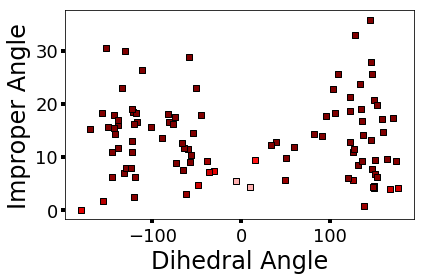

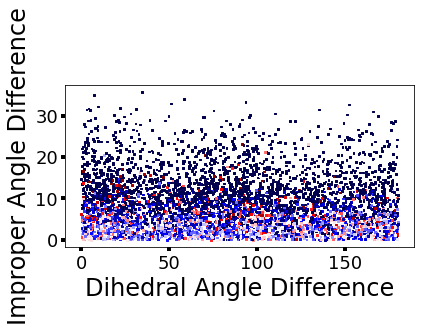

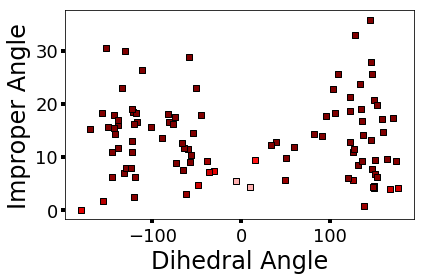

In [99]:
#os.chdir("/Users/andrewkleinschmidt/Test_New_Torsional_Setup")
#dill.load_session("N2200_env.db")

Check_New_Torsional_Energy(Ring_List,Polymer_Name,Rotated_Shape,a_params_list,b_params_list,a0_params_list,OPLS_Fit_list,Conjugated_Parameters,Nonbonded_a_params_list,Nonbonded_b_params_list,Nonbonded_a0_params_list)

In [100]:
Compare_Rigidity_Types(Merged_Conjugation_Energies,Merged_Delocalization_Energies,Merged_Nonbonded_Energies,Merged_OOP_Rotations_Degrees)

In [101]:
print("hi")
reload(Molecule)
reload(Atom)
reload(Conjugated_Polymer)
Write_Conventional_Data_File(Polymer_Name,Input_File_Sidechains,XYZ_File_Sidechains,15,OPLS_Fit_list,Folder_Name="Conventional_Scripts")

hi
Setting up molecule
Molecule Name: P3HT_Input_With_Sidechains
102 Atoms in  P3HT_Input_With_Sidechains
----------------------------------
Initial XYZ Coordinates:

C [-3.2529e+00 -6.0306e-01 -1.2900e-03]
C [-2.83211e+00  7.15280e-01  8.30000e-04]
S [-1.87924e+00 -1.60980e+00  1.66000e-03]
C [-7.3435e-01 -3.1104e-01  3.9000e-04]
C [-1.40259e+00  9.18570e-01  8.00000e-04]
H [-3.53423e+00  1.53934e+00  8.80000e-04]
C [-7.72000e-01  2.30268e+00 -4.00000e-05]
C [-1.75171e+00  3.48477e+00  7.70000e-04]
H [-0.13856  2.39289 -0.89059]
H [-0.13769  2.39389  0.88974]
C [-1.02693  4.83472 -0.00892]
H [-2.39489  3.43208  0.88816]
H [-2.40417  3.42635 -0.87944]
C [-2.02934e+00  5.99280e+00  2.61000e-03]
H [-0.39159  4.90565 -0.89993]
H [-0.3698   4.90812  0.86594]
C [-1.32965  7.3515  -0.02652]
H [-2.65673  5.9241   0.89983]
H [-2.69689  5.9082  -0.86373]
C [-2.33472e+00  8.49360e+00 -6.52000e-03]
H [-0.71135  7.43313 -0.92792]
H [-0.66087  7.44627  0.83669]
H [-3.00405  8.44329 -0.87143]
H [-1.

In [102]:
Write_Conventional_Data_File(Polymer_Name + "_Noninteracting",Input_File_Sidechains,XYZ_File_Sidechains,15,OPLS_Fit_list,Folder_Name="Conventional_Scripts",Non_Interacting=True)

Setting up molecule
Molecule Name: P3HT_Input_With_Sidechains
102 Atoms in  P3HT_Input_With_Sidechains
----------------------------------
Initial XYZ Coordinates:

C [-3.2529e+00 -6.0306e-01 -1.2900e-03]
C [-2.83211e+00  7.15280e-01  8.30000e-04]
S [-1.87924e+00 -1.60980e+00  1.66000e-03]
C [-7.3435e-01 -3.1104e-01  3.9000e-04]
C [-1.40259e+00  9.18570e-01  8.00000e-04]
H [-3.53423e+00  1.53934e+00  8.80000e-04]
C [-7.72000e-01  2.30268e+00 -4.00000e-05]
C [-1.75171e+00  3.48477e+00  7.70000e-04]
H [-0.13856  2.39289 -0.89059]
H [-0.13769  2.39389  0.88974]
C [-1.02693  4.83472 -0.00892]
H [-2.39489  3.43208  0.88816]
H [-2.40417  3.42635 -0.87944]
C [-2.02934e+00  5.99280e+00  2.61000e-03]
H [-0.39159  4.90565 -0.89993]
H [-0.3698   4.90812  0.86594]
C [-1.32965  7.3515  -0.02652]
H [-2.65673  5.9241   0.89983]
H [-2.69689  5.9082  -0.86373]
C [-2.33472e+00  8.49360e+00 -6.52000e-03]
H [-0.71135  7.43313 -0.92792]
H [-0.66087  7.44627  0.83669]
H [-3.00405  8.44329 -0.87143]
H [-1.816

In [103]:
Conjugated_Ring_List = []
for i in range(0,len(Ring_List),2):
    Conjugated_Ring_List.append(Ring_List[i+1])
    Conjugated_Ring_List.append(Ring_List[i])

for ring,params in zip(Conjugated_Ring_List,Conjugated_Parameters):
    for b_atom in ring.Bonded_Atoms:
        b_atom.Add_Improper_Params(params[0],params[1],params[2])

In [104]:
Polymer_Rings,Parameterize_Bond,Parameterize_Charges = Read_Input(Input_File_Sidechains,XYZ_File_Sidechains,Polymer_Name)

Conjugated_Polymer_Ring_List = []
for i in range(0,len(Polymer_Rings),2):
    Conjugated_Polymer_Ring_List.append(Polymer_Rings[i+1])
    Conjugated_Polymer_Ring_List.append(Polymer_Rings[i])

for ring,params in zip(Conjugated_Polymer_Ring_List,Conjugated_Parameters):
    for b_atom in ring.Bonded_Atoms:
        b_atom.Add_Improper_Params(params[0],params[1],params[2])

Setting up molecule
Molecule Name: P3HT_Input_With_Sidechains
102 Atoms in  P3HT_Input_With_Sidechains
----------------------------------
Initial XYZ Coordinates:

C [-3.2529e+00 -6.0306e-01 -1.2900e-03]
C [-2.83211e+00  7.15280e-01  8.30000e-04]
S [-1.87924e+00 -1.60980e+00  1.66000e-03]
C [-7.3435e-01 -3.1104e-01  3.9000e-04]
C [-1.40259e+00  9.18570e-01  8.00000e-04]
H [-3.53423e+00  1.53934e+00  8.80000e-04]
C [-7.72000e-01  2.30268e+00 -4.00000e-05]
C [-1.75171e+00  3.48477e+00  7.70000e-04]
H [-0.13856  2.39289 -0.89059]
H [-0.13769  2.39389  0.88974]
C [-1.02693  4.83472 -0.00892]
H [-2.39489  3.43208  0.88816]
H [-2.40417  3.42635 -0.87944]
C [-2.02934e+00  5.99280e+00  2.61000e-03]
H [-0.39159  4.90565 -0.89993]
H [-0.3698   4.90812  0.86594]
C [-1.32965  7.3515  -0.02652]
H [-2.65673  5.9241   0.89983]
H [-2.69689  5.9082  -0.86373]
C [-2.33472e+00  8.49360e+00 -6.52000e-03]
H [-0.71135  7.43313 -0.92792]
H [-0.66087  7.44627  0.83669]
H [-3.00405  8.44329 -0.87143]
H [-1.816

In [105]:
Polymer_Ring_List = []
for i in range(15):
    for ring in Polymer_Rings:
        Polymer_Ring_List.append(copy.deepcopy(ring))

for ring,params in zip(Polymer_Ring_List,Conjugated_Parameters):
    for b_atom in ring.Bonded_Atoms:
        b_atom.Add_Improper_Params(params[0],params[1],params[2])

In [106]:
reload(Atom)
reload(Conjugated_Polymer)

Write_Example_Plumed_Script(Polymer_Ring_List,Fit_Energies,Force_y,Force_x,Polymer_Name,Folder_Name="./Full_Polymer_Plumed") #Plumed Script for full polymer
Write_Example_Plumed_Script(Polymer_Ring_List,Fit_Energies,Force_y,Force_x,Polymer_Name+"_Noninteracting",Folder_Name="./Full_Polymer_Plumed",Non_Interacting=True,Nonbonded_Fit_Energies=Nonbonded_Fit_Energies,Nonbonded_Force_x=Nonbonded_Force_x,Nonbonded_Force_y=Nonbonded_Force_y) #Plumed Script for full polymer with no LJ and Coulombic interactions

Linking Now
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'S']
C
['C', 'C', 'C']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'H', 'H', 'H']
S
H
New H Atom
C
2
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
8
H
New H Atom
C
8
H
New H Atom
C
11
H
New H Atom
C
11
H
New H Atom
C
14
H
New H Atom
C
14
H
New H Atom
C
17
H
New H Atom
C
17
H
New H Atom
C
20
H
New H Atom
C
20
H
New H Atom
C
20
H
New H Atom
C
1
C
['

In [107]:
reload(Molecule)
reload(Conjugated_Polymer)
reload(System)
import sys
sys.setrecursionlimit(10000)
Polymer = Conjugated_Polymer.Conjugated_Polymer(Polymer_Ring_List)

Bond_Atoms = []
for bond in Polymer.Interring_Bond_List:
        if bond.Bond_Master not in Bond_Atoms:
            Bond_Atoms.append(bond.Bond_Master)
        if bond.Bond_Slave not in Bond_Atoms:
            Bond_Atoms.append(bond.Bond_Slave)
System_List = []
#Comp_List = np.ones(60,dtype=int)
Comp_List = np.ones(30,dtype=int)
#for poly in range(60):
for poly in range(30):
    Polymer = Conjugated_Polymer.Conjugated_Polymer(Polymer_Ring_List)
    Polymer.Replace_Interring_Dihedrals(0,0,[0.0,0.0,0.0,0.0])
    Molecule.Assign_Lammps([Polymer])
    for atom in Polymer.Atom_List:
        atom.Charge = 0.0
        atom.Epsilon = 0.0
        atom.Sigma = 4.0
    Polymer.Randomize_Torsions(Deloc_Coarse_Energies[0][3:-3]/4.184,Nonbonded_Coarse_Energies[0][3:-3]/4.184)
    System_List.append(copy.deepcopy(Polymer))
#Film = System.System(System_List,Comp_List,80.0,"PNDI_T_Film_60_30mers")
Film = System.System(System_List,Comp_List,64.0,"P3HT_Film_30_30mers_COLVAR_torsion")
Film.Gen_Rand()
Film.Write_LAMMPS_Data()
Film.Write_Plumed_Files(Comp_List,"P3HT_Film",Fit_Energies,Force_y,Force_x,Reverse = True,Folder_Name="./Full_Polymer_Plumed")
#Polymer.Write_Data_File("Test_Randomize.data",Exclude_Interring_Dihedrals=True,Bond_Atoms=Bond_Atoms,Soft_Potential=True)

Linking Now
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
Linking Now
4
1
5
Linking Now
5
1
4
C
['C', 'H', 'S']
C
['C', 'C', 'H']
C
['C', 'C', 'S']
C
['C', 'C', 'C']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'C', 'H', 'H']
C
['C', 'H', 'H', 'H']
S
H
New H Atom
C
2
H
New H Atom
C
7
H
New H Atom
C
7
H
New H Atom
C
8
H
New H Atom
C
8
H
New H Atom
C
11
H
New H Atom
C
11
H
New H Atom
C
14
H
New H Atom
C
14
H
New H Atom
C
17
H
New H Atom
C
17
H
New H Atom
C
20
H
New H Atom
C
20
H
New H Atom
C
20
H
New H Atom
C
1
C
['

/Users/andrewkleinschmidt/AROMODEL/AROMODEL/System.py:169: RuntimeWarning: invalid value encountered in longdouble_scalars
  dQ = np.longdouble(abs(Q/Num_Atoms))


AttributeError: 'Ring' object has no attribute 'Plumed_Rings'

In [ ]:
reload(Molecule)
reload(Conjugated_Polymer)
reload(System)
import sys
sys.setrecursionlimit(10000)
Conventional_Polymer = Conjugated_Polymer.Conjugated_Polymer(Polymer_Ring_List)
Molecule.Assign_Lammps([Conventional_Polymer])
Conventional_Polymer.Replace_Interring_Dihedrals(0,0,OPLS_Fit_list[0])
Bond_Atoms = []
for bond in Conventional_Polymer.Interring_Bond_List:
        if bond.Bond_Master not in Bond_Atoms:
            Bond_Atoms.append(bond.Bond_Master)
        if bond.Bond_Slave not in Bond_Atoms:
            Bond_Atoms.append(bond.Bond_Slave)
System_List = []
#Comp_List = np.ones(60,dtype=int)
Comp_List = np.ones(30,dtype=int)
#for poly in range(60):
for atom in Conventional_Polymer.Atom_List:
    atom.Charge = 0.0
    atom.Epsilon = 0.0
    atom.Sigma = 4.0
for poly in range(30):
    System_List.append(copy.deepcopy(Conventional_Polymer))

#Film = System.System(System_List,Comp_List,80.0,"PNDI_T_Film_60_30mers")
Film = System.System(System_List,Comp_List,64.0,"P3HT_Film_30_30mers_Dihedral_torsion")
Film.Gen_Rand()
Film.Update_Atom_Positions("P3HT_Film_30_30mers_COLVAR_torsion.data")
Film.Write_LAMMPS_Data()

In [ ]:
fig,ax = plt.subplots(1,1)
ax.plot(Dih_Rotations,E_delocalization[0][0],label="Colvar-Torsion")
ax.plot(Dih_Rotations,Dimer_Energies[0][0],label="Dihedral-Torsion")
plt.xlabel("Degrees ()",size=24)
plt.ylabel("Energy (kcal/mol)",size=24)
plt.tight_layout()
ax.legend()
fig.savefig('%s_Figure2' % ("P3HT"))
print()

In [ ]:
Reverse = False
Base_Calculate_Torsions_String = Polymer_Name + "_Calculate_Torsions_Conventional"
index = 1
Num_Atoms = 1
Num_Rings = 0
oop_blocks = np.linspace(0,2*math.pi,200)
dih_blocks = np.linspace(-math.pi,math.pi,200)
torsion_file = open(Base_Calculate_Torsions_String + ".dat", 'w')
for mol in Film.Molecule_List:
    Bond_Atoms = []
    for bond in mol.Interring_Bond_List:
        if bond.Bond_Master not in Bond_Atoms:
            Bond_Atoms.append(bond.Bond_Master)
        if bond.Bond_Slave not in Bond_Atoms:
            Bond_Atoms.append(bond.Bond_Slave)

    torsion_file.write("\n\nc%d: CENTER ATOMS=%d" % (index,mol.Ring_List[0].Core_Atom_List[0].System_ID))
    for atom in mol.Ring_List[0].Core_Atom_List[1:]:
        torsion_file.write(",%d" % atom.System_ID)
    torsion_file.write("\n\nc%d_normal: GHOST ATOMS=c1,%d,%d COORDINATES=0.0,1.0,0.0\n\n" % (index,mol.Ring_List[0].Core_Atom_List[0].System_ID,mol.Ring_List[0].Core_Atom_List[1].System_ID))

    for i in range(1,len(mol.Ring_List)):
        index += 1
        for b_atom in mol.Ring_List[i].Bonded_Atoms:
            if b_atom.Is_Linked and b_atom.Interring_Bond_Atom.Self_Ring.Ring_ID == i:
                atom1 = b_atom.Interring_Bond_Atom.Central_Atom.System_ID
                atom2 = b_atom.Central_Atom.System_ID
                ring1_batom1 = b_atom.Interring_Bond_Atom.Same_Ring_Bonded_Atom_List[0].System_ID
                ring1_batom2 = b_atom.Interring_Bond_Atom.Same_Ring_Bonded_Atom_List[1].System_ID
                ring2_batom1 = b_atom.Same_Ring_Bonded_Atom_List[0].System_ID
                ring2_batom2 = b_atom.Same_Ring_Bonded_Atom_List[1].System_ID
        torsion_file.write("\n\nc%d: CENTER ATOMS=%d" % (index,mol.Ring_List[i].Core_Atom_List[0].System_ID))
        for atom in mol.Ring_List[i].Core_Atom_List[1:]:
            torsion_file.write(",%d" % atom.System_ID)
        torsion_file.write("\n\nc%d_normal: GHOST ATOMS=c%d,%d,%d COORDINATES=0.0,1.0,0.0\n\n" % (index,index,mol.Ring_List[i].Core_Atom_List[0].System_ID,mol.Ring_List[i].Core_Atom_List[1].System_ID))
        if Reverse:
            torsion_file.write("DIH_%d: TORSION VECTOR1=c%d_normal,c%d AXIS=%d,%d VECTOR2=c%d_normal,c%d\n\n" % (index-1,index-1,index-1,atom2,atom1,index,index))
        else:
            torsion_file.write("DIH_%d: TORSION VECTOR1=c%d,c%d_normal AXIS=%d,%d VECTOR2=c%d,c%d_normal\n\n" % (index-1,index-1,index-1,atom1,atom2,index,index))
        torsion_file.write("OOP_%d_1: TORSION ATOMS=%d,%d,%d,%d\n\n" % (index-1,atom1,ring1_batom1,ring1_batom2,atom2))
        torsion_file.write("OOP_%d_2: TORSION ATOMS=%d,%d,%d,%d\n\n" % (index-1,atom2,ring2_batom1,ring2_batom2,atom1))
        torsion_file.write("OOP_%d: MATHEVAL ARG=OOP_%d_1,OOP_%d_2 FUNC=abs(x)+abs(y) PERIODIC=NO\n\n" % (index-1,index-1,index-1))
        torsion_file.write("PRINT ARG=DIH_%d,OOP_%d FILE=colvar_%d.txt STRIDE=100\n\n" % (index-1,index-1,index-1))

    torsion_file.write("WHOLEMOLECULES ENTITY0=%d-%d" % (Num_Atoms,Num_Atoms+len(mol.Atom_List)-1))
    Num_Atoms += len(mol.Atom_List)
    Num_Rings += len(mol.Ring_List)
    for i in range(1,len(mol.Ring_List)):
        torsion_file.write(",c%d,c%d_normal" % (i,i))
    index += 1

torsion_file.close()

In [ ]:
Sub_Directory = "./Polymer_Plumed_P3HT"
Colvars = f.readlines()
torsion_index = 1
torsion_indices = []
for polymer_num in range(30):
    for torsion_num in range(30):
        torsion_indices.append(torsion_index)
        torsion_index += 1
    torsion_index += 1
for colvar_num in torsion_indices:
    f = open(Sub_Directory + "/colvar_%d.txt" % colvar_num,'r')
    for line in Colvars[-1::-1]:
        if len(line.strip().split()) == 3 and all((ch.isdigit() or ch == ".") for ch in line.strip().split()[0].strip()):
            Colvar_DIH_List.append(float(line.strip().split()[1].strip()))
            Colvar_OOP_List.append(float(line.strip().split()[2].strip()))
            break
    f.close()

In [ ]:
Nonbonded_Modifiers = [0.0,0.5,1.0,2.0]
Delocalization_Modifiers = [0.0,0.5,1.0,2.0]

for n_mod in Nonbonded_Modifiers:
    for d_mod in Delocalization_Modifiers:
        Write_Example_Plumed_Script(Polymer_Ring_List,Fit_Energies,Force_y,Force_x,Polymer_Name+"_Noninteracting",Folder_Name="./Full_Polymer_Plumed",Non_Interacting=True,Nonbonded_Fit_Energies=Nonbonded_Fit_Energies,Nonbonded_Force_x=Nonbonded_Force_x,Nonbonded_Force_y=Nonbonded_Force_y,Delocalization_Modifier=d_mod,Nonbonded_Modifier=n_mod)

In [ ]:
Make_Solvated_Box(Polymer_Ring_List,Polymer_Name,"Chlorobenzene")

In [ ]:
Ring_By_Ring_Total_Trimer_Energy = Return_SPE_Trimers_Dih(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Trimer,Dimer_Energies_Dict,Ring_By_Ring_Trimer_Nontorsional_Energy)

Ring_By_Ring_Hydrogenated_Trimer_Energy =  Return_SPE_Trimers_Hydrogenated_Dih(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,Ring_By_Ring_End_File_Matrices_Hydrogenated_Trimer,Dimer_Energies_Dict,Ring_By_Ring_Trimer_Nontorsional_Energy)

Calculate_Trimer_Long_Range_Energy(Ring_List,Rotated_Shape,Max_Dih,Max_OOP,Polymer_Name,E_delocalization,Ring_By_Ring_Hydrogenated_Improper_Energies,Ring_By_Ring_Total_Trimer_Energy,Ring_By_Ring_Hydrogenated_Trimer_Energy,Ring_By_Ring_End_File_Matrices_Trimer,Dually_Hydrogenated_Energies,Ring_By_Ring_Nonbonded_Energies)
for names,energies in zip(Dimer_Names,Ring_By_Ring_Nonbonded_Energies):
    energies = energies - np.amin(energies[0])
    fig,ax = plt.subplots(1,1)
    x,y = np.meshgrid(Dih_Rotations_Degrees,OOP_Rotations_Degrees)
    c = ax.pcolor(x,y,energies,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Nonbonded Energies',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Nonbonded_Energies' % (names[0],names[1]))
    plt.close(fig)

for names,reg_tracker,improper_tracker in zip(Dimer_Names,Combined_Ring_By_Ring_Hydrogenated_Energies_Tracker,Combined_Ring_By_Ring_Hydrogenated_Improper_Energies_Tracker):
    energies = energies - np.amin(energies[0])
    fig,ax = plt.subplots(1,1)
    x,y = np.meshgrid(Dih_Rotations_Degrees,OOP_Rotations_Degrees)
    c = ax.pcolor(x,y,energies,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Nonbonded Energies',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Nonbonded_Energies' % (names[0],names[1]))
    plt.close(fig)

    fig,ax = plt.subplots(1,1)
    c = ax.pcolor(x,y,reg_tracker,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Tracker',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Hydrogenated_Tracker' % (names[0],names[1]))
    plt.close(fig)

    fig,ax = plt.subplots(1,1)
    c = ax.pcolor(x,y,improper_tracker,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Tracker',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Hydrogenated_Improper_Tracker' % (names[0],names[1]))
    plt.close(fig)

for names,energies in zip(Dimer_Names,E_delocalization):
    energies = energies - np.amin(energies[0])
    fig,ax = plt.subplots(1,1)
    x,y = np.meshgrid(Dih_Rotations_Degrees,OOP_Rotations_Degrees)
    c = ax.pcolor(x,y,energies,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Delocalization Energies',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Delocalization_Energies' % (names[0],names[1]))
    plt.close(fig)

    Normalized_Energy_List = []

    fig,ax = plt.subplots(1,1)
    for energy_list in energies:
        norm_energies = energy_list - np.amin(energy_list)
        plt.scatter(np.linspace(0,350,Rotated_Shape[1]),energy_list)
        Normalized_Energy_List.append(norm_energies)

    plt.ylabel('Energy (kcal/mol)',size = 24)
    plt.xlabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    plt.ylim([-10,10])
    fig.savefig('%s_%s_Delocalization_Energies_Row_By_Row' % (names[0],names[1]))
    plt.close(fig)


    for i in range(len(energies)):
        fig,ax = plt.subplots(1,1)
        for energy_list in energies[:i]:
            plt.scatter(np.linspace(0,350,Rotated_Shape[1]),energy_list,alpha=0.2,marker = 's',c='k')

        plt.scatter(np.linspace(0,350,Rotated_Shape[1]),energies[i],marker = 's',c='k')
        plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
        plt.ylabel('Energy (kcal/mol)',size = 24)
        ax.tick_params(axis="x", labelsize=18)
        ax.tick_params(axis="y", labelsize=18)
        ax.tick_params(length=4,width=4)
        plt.ylim([-10,15])
        plt.tight_layout()
        fig.savefig('%s_%s_Delocalization_Energies_Row_By_Row_%d' % (names[0],names[1],i))
        plt.close(fig)
        os.system("scp %s_%s_Delocalization_Energies_Row_By_Row_%d.png ./Figures" % (names[0],names[1],i))
        os.system("rm -f %s_%s_Delocalization_Energies_Row_By_Row_%d.png" % (names[0],names[1],i))

    for i in range(len(energies[0])):
        fig,ax = plt.subplots(1,1)

        plt.scatter(np.linspace(0,350,Rotated_Shape[1]),energies[0],marker = 's',c='k')
        plt.scatter([np.linspace(0,350,Rotated_Shape[1])[i]],[energies[0][i]],marker = 's',c='k',edgecolors='r',linewidths = 2.25)
        plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
        plt.ylabel('Energy (kcal/mol)',size = 24)
        ax.tick_params(axis="x", labelsize=18)
        ax.tick_params(axis="y", labelsize=18)
        ax.tick_params(length=4,width=4)
        plt.ylim([-10,15])
        plt.tight_layout()
        fig.savefig('%s_%s_Delocalization_Energies_First_Row_%d' % (names[0],names[1],i))
        plt.close(fig)
        os.system("scp %s_%s_Delocalization_Energies_First_Row_%d.png ./Figures" % (names[0],names[1],i))
        os.system("rm -f %s_%s_Delocalization_Energies_First_Row_%d.png" % (names[0],names[1],i))

    fig,ax = plt.subplots(1,1)
    x,y = np.meshgrid(Dih_Rotations_Degrees,OOP_Rotations_Degrees)
    c = ax.pcolor(x,y,Normalized_Energy_List,cmap = 'seismic',vmin=0,vmax=10)
    ax.set_title('Delocalization Energies (Adjusted)',fontdict = {'fontsize':24})
    plt.xlabel('Dihedral Angle ($^\circ$)',size = 24)
    plt.ylabel('OOP Angle ($^\circ$)',size = 24)
    ax.tick_params(axis="x", labelsize=18)
    ax.tick_params(axis="y", labelsize=18)
    ax.tick_params(length=4,width=4)
    fig.savefig('%s_%s_Delocalization_Energies_Normalized' % (names[0],names[1]))
    plt.close(fig)
